# Multi-Modal RAG

this tutorial, we will demo how to build a Multi-Modal RAG pipeline running with a [Llava](https://huggingface.co/llava-hf/llava-1.5-7b-hf) model.

We will use a pipeline that will:

- Fetch relevant documents with images for our question.
- Run the Multi-Modal LLM to answer the question.

For more information about Llava, we refer to the [original repository](https://github.com/haotian-liu/LLaVA).

In [1]:
from haystack import Pipeline, Document
from haystack.document_stores.in_memory import InMemoryDocumentStore
from haystack.components.writers import DocumentWriter
from haystack.components.embedders import SentenceTransformersDocumentEmbedder

First, lets load some multi-modal data:

In [2]:
import json
entries = json.load(open("../assets/multi_modal_files/intel_image_data.json", "r"))

Each entry contains a brief textual description, with a title and an image:

In [3]:
documents = [
    Document(
        content=entry["content"],
        meta={
            "image_url": entry["image_url"],
            "title": entry["title"],
        }
    )
    for entry in entries    
]

Next, we create an index for the documents above:

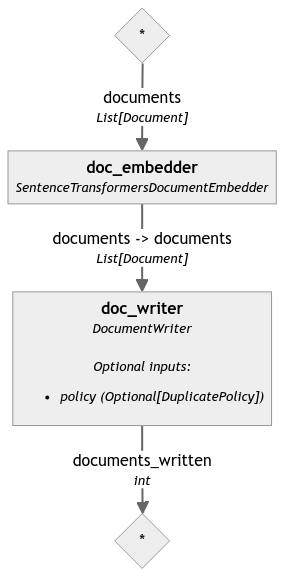

In [4]:
document_store = InMemoryDocumentStore()

indexing_pipeline = Pipeline()
indexing_pipeline.add_component(
    instance=SentenceTransformersDocumentEmbedder(model="sentence-transformers/all-MiniLM-L6-v2"), name="doc_embedder"
)
indexing_pipeline.add_component(instance=DocumentWriter(document_store=document_store), name="doc_writer")

indexing_pipeline.connect("doc_embedder.documents", "doc_writer.documents")


In [5]:
indexing_pipeline.run({"doc_embedder": {"documents": documents}})

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

{'doc_writer': {'documents_written': 3}}

With our index ready, lets create a multi-modal generator with the ```LlavaHFGenerator``` component.

In [6]:
from fastrag.generators.llava import LlavaHFGenerator

generator = LlavaHFGenerator(
    model = "llava-hf/llava-1.5-7b-hf",
    task = "image-to-text",
    generation_kwargs = {
        "max_new_tokens": 100,
    },
)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Next, we will use our Llava model and our index to create a RAG pipeline.

Notice that we connect both the textual prompt, and the images from the retriever to the LLM:

In [7]:
from haystack.components.embedders import SentenceTransformersTextEmbedder
from haystack.components.retrievers.in_memory import InMemoryEmbeddingRetriever
from fastrag.prompt_builders.multi_modal_prompt_builder import MultiModalPromptBuilder
from haystack.components.builders import PromptBuilder
from haystack.components.generators import OpenAIGenerator

template = """
Answer the questions based on the given context.

Context:
{% for document in documents %}
    {{ document.content }}
{% endfor %}
Question: {{ question }}
Answer:
"""
rag_pipe = Pipeline()
rag_pipe.add_component("embedder", SentenceTransformersTextEmbedder(model="sentence-transformers/all-MiniLM-L6-v2"))
rag_pipe.add_component("retriever", InMemoryEmbeddingRetriever(document_store=document_store))
rag_pipe.add_component("prompt_builder", MultiModalPromptBuilder(template=template))
rag_pipe.add_component("llm", generator)

rag_pipe.connect("embedder.embedding", "retriever.query_embedding")
rag_pipe.connect("retriever", "prompt_builder.documents")
rag_pipe.connect("prompt_builder.prompt", "llm.prompt")
rag_pipe.connect("prompt_builder.images", "llm.images")
print(f"LLM pipeline created")

LLM pipeline created


Now, lets ask a question:

In [8]:
query = "Give me an image of the Headquarters in Santa Clara. What is the color of the building?"
rag_res = rag_pipe.run({
    "embedder": {
        "text": query,
    }, 
    "retriever": {
        "top_k": 1
    },
    "prompt_builder": {
        "question": query
    }
})

  warnings.warn(


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

<s> Current Images: <image> 

Answer the questions based on the given context.

Context:

    Headquarters in Santa Clara, California, in 2023

Question: Give me an image of the Headquarters in Santa Clara. What is the color of the building?
Answer: The building is blue.</s>


Lets look at the image to check if the answer is correct:

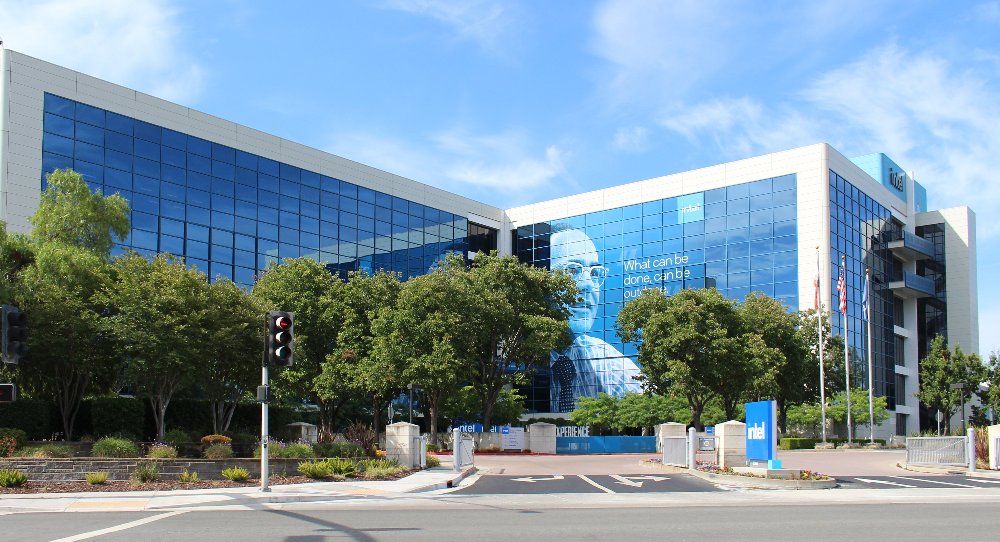

In [9]:
rag_res["llm"]["raw_images"][0]

Great! the answer is correct indeed.